In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
import plotly.graph_objects as go
import plotly.offline as pyo
pyo.init_notebook_mode()
import duckdb
import warnings
warnings.filterwarnings("ignore")

# Checking Data



In [2]:
transactions = pd.read_csv('transactions_1.csv')
transactions

,time,status,f0_
0,00h 00,approved,9
1,00h 00,denied,6
2,00h 00,refunded,1
3,00h 01,denied,8
4,00h 01,approved,13
...,...,...,...
4229,23h 59,processing,4
4230,23h 59,denied,1
4231,23h 59,backend_reversed,5
4232,23h 59,approved,10


In [3]:
transactions2 = pd.read_csv('transactions_2.csv')
transactions2

,time,status,count
0,00h 00,reversed,7
1,00h 00,approved,9
2,00h 00,processing,12
3,00h 00,denied,3
4,00h 00,backend_reversed,2
...,...,...,...
3939,23h 57,denied,11
3940,23h 58,denied,4
3941,23h 58,approved,35
3942,23h 59,denied,10


# Checking for Problems in Data

In [4]:
print('_ % NaNs  __ First FIle ______')
for col in transactions.columns:
    pct = transactions[f'{col}'].isnull().sum() * 100 / len(transactions.index)
    print(f'{col} - {pct}%')
print('\n_ % NaNs  __ Second FIle ______')
for col in transactions2.columns:
    pct = transactions2[f'{col}'].isnull().sum() * 100 / len(transactions2.index)
    print(f'{col} - {pct}%')

_ % NaNs  __ First FIle ______
time - 0.0%
status - 0.0%
f0_ - 0.0%

_ % NaNs  __ Second FIle ______
time - 0.0%
status - 0.0%
count - 0.0%


In [5]:
print('_ % Zeros  __ First File ______')
for col in transactions.columns:
    pct = len(transactions[transactions[f'{col}']==0].index) * 100 / len(transactions.index)
    print(f'{col} - {pct}%')
print('\n_ % Zeros  __ Second File ______')
for col in transactions2.columns:
    pct = len(transactions2[transactions2[f'{col}']==0].index) * 100 / len(transactions2.index)
    print(f'{col} - {pct}%')

_ % Zeros  __ First File ______
time - 0.0%
status - 0.0%
f0_ - 0.0%

_ % Zeros  __ Second File ______
time - 0.0%
status - 0.0%
count - 0.0%


In [6]:
print('_ % Duplicates Row Wise __ First FIle ______')
for col in transactions.columns:
    non_duplicates = len(transactions.drop_duplicates(keep='first').index)
    duplicates = len(transactions.index) - non_duplicates
    pct = duplicates * 100 / len(transactions.index)
    print(f'{col} - {pct}%')

print('\n_ % Duplicates Row Wise __ Second FIle ______')
for col in transactions2.columns:
    non_duplicates = len(transactions2.drop_duplicates(keep='first').index)
    duplicates = len(transactions2.index) - non_duplicates
    pct = duplicates * 100 / len(transactions2.index)
    print(f'{col} - {pct}%')

_ % Duplicates Row Wise __ First FIle ______
time - 0.0%
status - 0.0%
f0_ - 0.0%

_ % Duplicates Row Wise __ Second FIle ______
time - 0.0%
status - 0.0%
count - 0.0%


In [7]:
print('_ % Duplicates Column Wise __ First FIle ______')
for col in transactions.columns:
    non_duplicates = len(transactions.drop_duplicates(col, keep='first').index)
    duplicates = len(transactions.index) - non_duplicates
    pct = duplicates * 100 / len(transactions.index)
    print(f'{col} - {pct}%')

print('\n_ % Duplicates Column Wise __ Second FIle ______')
for col in transactions2.columns:
    non_duplicates = len(transactions2.drop_duplicates(col, keep='first').index)
    duplicates = len(transactions2.index) - non_duplicates
    pct = duplicates * 100 / len(transactions2.index)
    print(f'{col} - {pct}%')

_ % Duplicates Column Wise __ First FIle ______
time - 68.77657061880019%
status - 99.83467170524327%
f0_ - 90.3873405762872%

_ % Duplicates Column Wise __ Second FIle ______
time - 66.55679513184585%
status - 99.82251521298174%
count - 88.56490872210954%


# Analysing Data Similarity

## Transforming and preparing data

In [8]:
transactions.rename(columns={'f0_':'count'}, inplace=True)

In [9]:
transactions = transactions.pivot_table(['count'],'time','status').droplevel(0,axis=1)
transactions.columns = ['approved','backend_reversed','denied','failed','processing','refunded','reversed']
transactions.fillna(0, inplace=True)


In [10]:
transactions2 = transactions2.pivot_table(['count'],'time','status').droplevel(0,axis=1)
transactions2.columns = ['approved','backend_reversed','denied','failed','processing','refunded','reversed']
transactions2.fillna(0, inplace=True)

In [11]:
transactions

,approved,backend_reversed,denied,failed,processing,refunded,reversed
time,,,,,,,
00h 00,9.0,0.0,6.0,0.0,0.0,1.0,0.0
00h 01,13.0,0.0,8.0,0.0,0.0,0.0,0.0
00h 02,11.0,0.0,7.0,0.0,0.0,1.0,0.0
00h 03,12.0,0.0,3.0,0.0,0.0,0.0,0.0
00h 04,11.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...
23h 55,32.0,0.0,4.0,0.0,0.0,0.0,0.0
23h 56,30.0,0.0,3.0,0.0,0.0,0.0,0.0
23h 57,21.0,0.0,4.0,0.0,0.0,0.0,1.0


In [12]:
transactions.iloc[800:1000]

,approved,backend_reversed,denied,failed,processing,refunded,reversed
time,,,,,,,
14h 40,17.0,4.0,2.0,0.0,8.0,0.0,31.0
14h 41,248.0,1.0,62.0,0.0,7.0,2.0,180.0
14h 42,434.0,3.0,87.0,0.0,0.0,13.0,193.0
14h 43,782.0,7.0,98.0,0.0,0.0,11.0,109.0
14h 44,305.0,6.0,54.0,1.0,14.0,1.0,82.0
...,...,...,...,...,...,...,...
18h 20,227.0,14.0,40.0,0.0,3.0,4.0,101.0
18h 22,49.0,5.0,14.0,0.0,3.0,2.0,18.0
18h 23,100.0,10.0,16.0,0.0,3.0,3.0,35.0


## Kolmogorov–Smirnov test

In [13]:
from scipy.stats import ks_2samp



for status in transactions.columns:
    first_sample = transactions[status]
    second_sample = transactions2[status]

   
    

    print(status, '\t',ks_2samp(first_sample, second_sample)[1], '\t\t\t', ks_2samp(first_sample, second_sample)[1]>0.05)   

approved 	 2.749048125448754e-13 			 False
backend_reversed 	 2.8130173420842248e-27 			 False
denied 	 6.314987236267669e-07 			 False
failed 	 1.3325827491135293e-07 			 False
processing 	 8.998373686853123e-10 			 False
refunded 	 0.04250709469575456 			 False
reversed 	 5.186332038015167e-12 			 False


## Distributions per Status

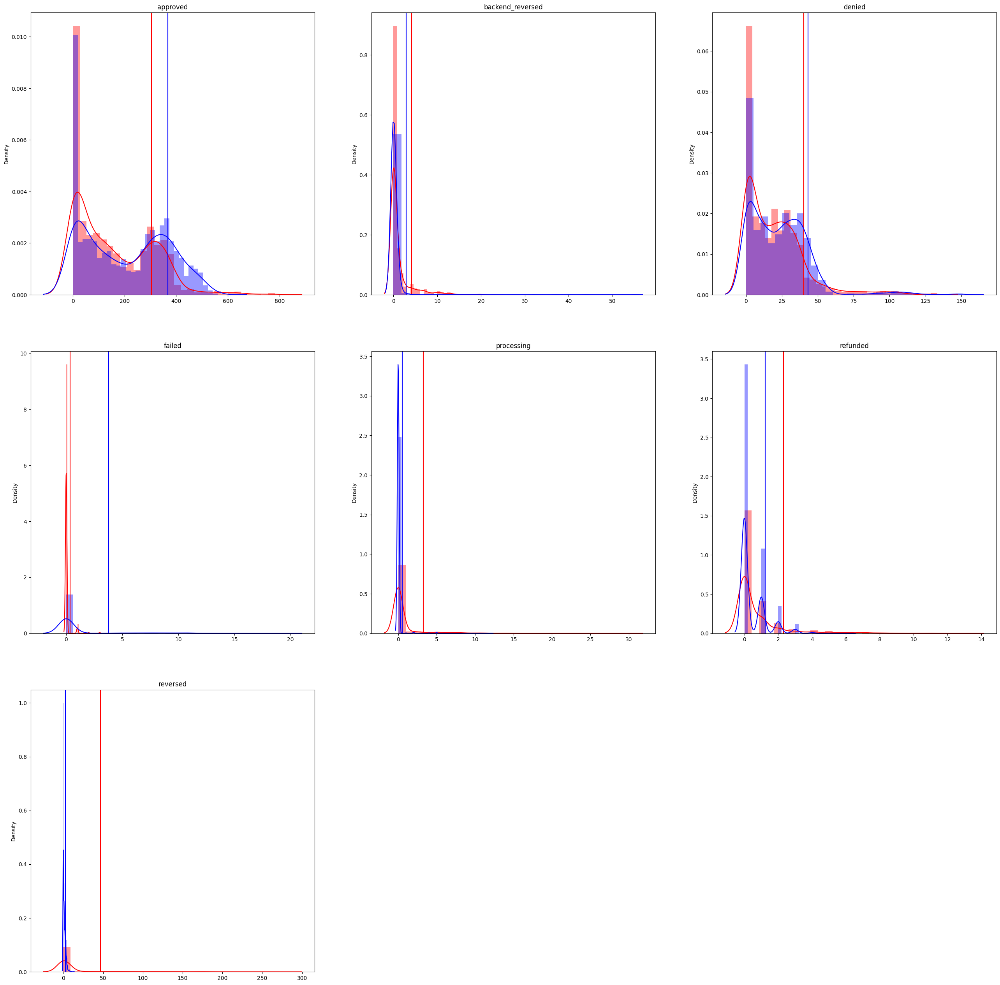

In [14]:

fig = plt.figure(figsize=(32,32))
fig.subplots_adjust(hspace=0.2, wspace=0.2)

for i, status in enumerate(transactions.columns):

    ax = fig.add_subplot(3, 3, i+1)

    first_sample = transactions[status]
    second_sample = transactions2[status]

    
    sns.distplot(x=first_sample, kde=True, bins=30, ax=ax, color='red')
    ax.axvline(np.mean(first_sample) + np.std(first_sample), color='red')
    sns.distplot(x=second_sample, kde=True, bins=30, ax=ax, color='blue')
    ax.axvline(np.mean(second_sample) + np.std(second_sample), color='blue')
    
    ax.set_title(str(status))


plt.show()


## Correlation

Text(0.5, 1.0, 'Correlation Map')

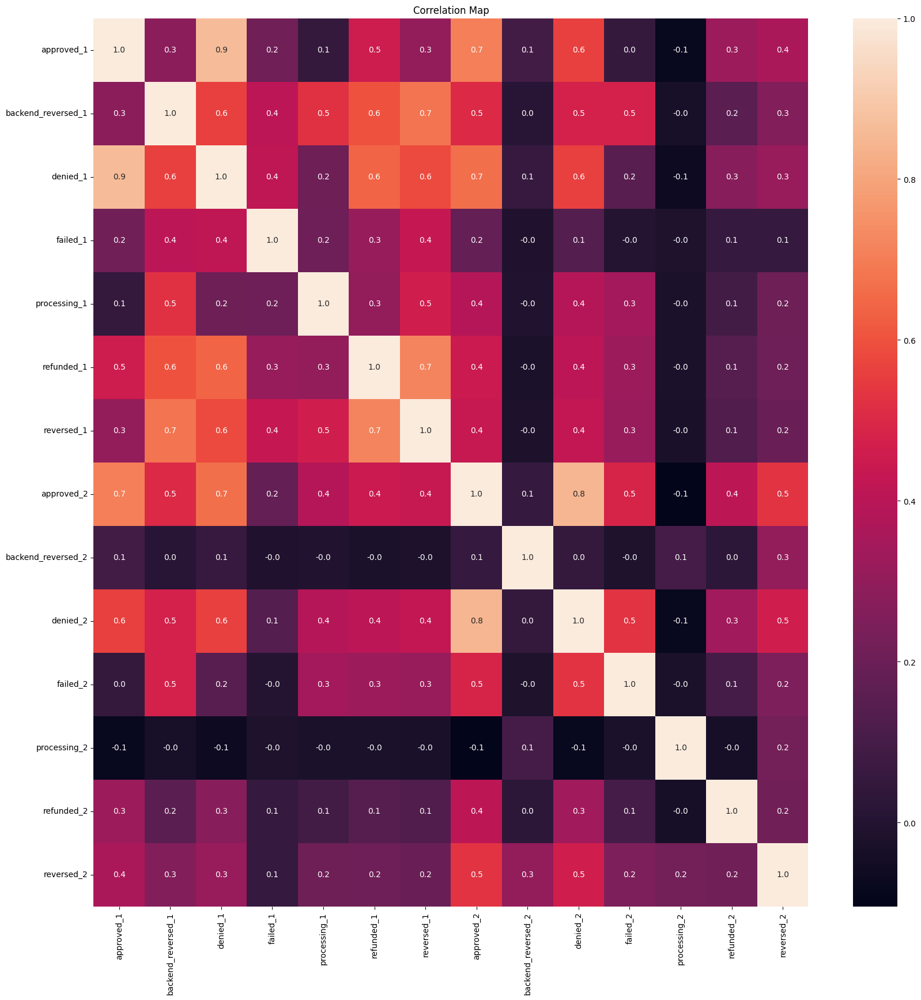

In [15]:
fig = plt.figure(figsize=(20,20))
corr_df = pd.merge(transactions, transactions2, how='left', on='time', suffixes=['_1','_2'])
sns.heatmap(corr_df.corr(), annot=True, fmt='.1f')
plt.title('Correlation Map')

Text(0.5, 1.0, 'Covariance Map')

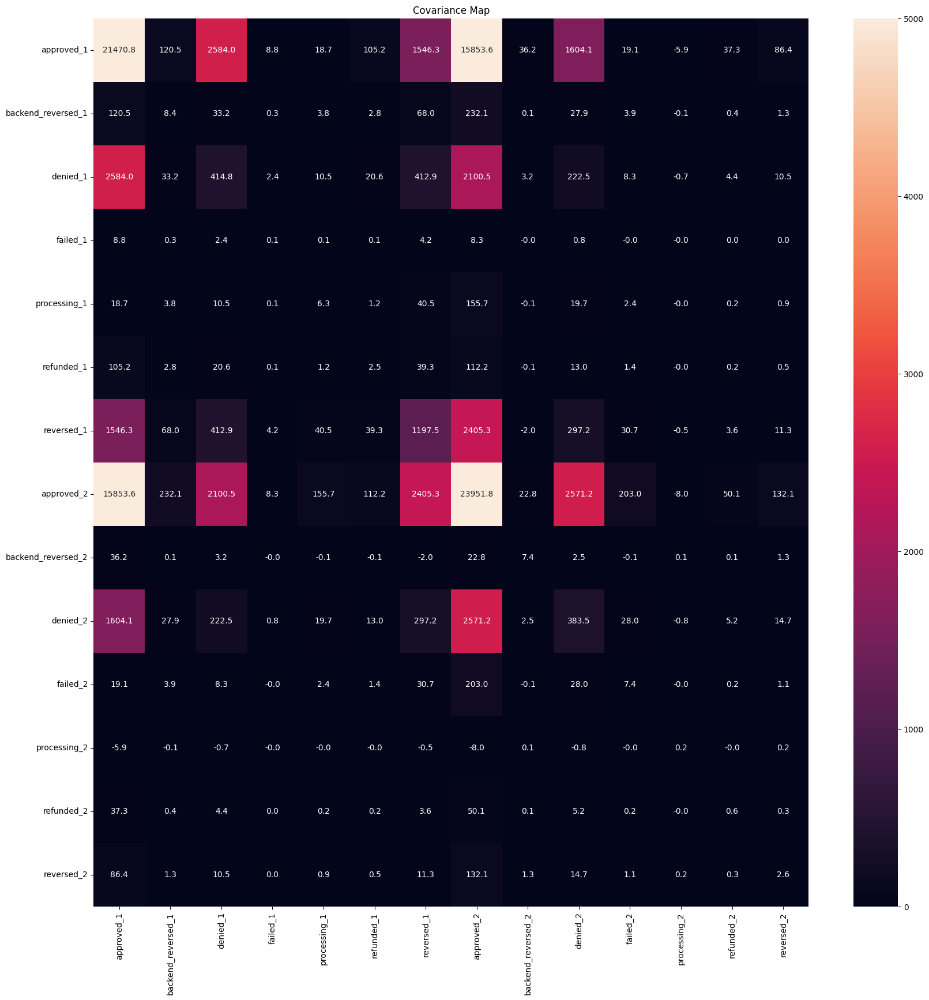

In [16]:
fig = plt.figure(figsize=(20,20))
corr_df = pd.merge(transactions, transactions2, how='left', on='time', suffixes=['_1','_2'])
sns.heatmap(corr_df.cov(), annot=True, fmt='.1f', vmin=0, vmax=5*10**3)
plt.title('Covariance Map')

Considering our context with **the first task**, and what we have analyzed, I think it is fair to assume these are from the same context and POS

**Reasons to believe so:**

- High correlations between approved 1 and 2, denied 1 and approved 2... basically high correlations between main data features
- High covariance between Approved sales
- With the context that other status are failures or anomalies, it makes sense that there will be divergences between these features
- Similar distributions even though the Kolmogorov test failed, with variances probably being normal and/or explainable

# Data Augmentation

We will be adding various feature engineering columns to better pronounce the anomalies in the data, but first we will do some necessary basic transformations.

In [17]:
transactions = pd.concat([transactions.sort_index(ascending=True), transactions2.sort_index(ascending=True)])
duckdb.query('''
SELECT * FROM transactions
''')

┌──────────┬──────────────────┬────────┬────────┬────────────┬──────────┬──────────┐
│ approved │ backend_reversed │ denied │ failed │ processing │ refunded │ reversed │
│  double  │      double      │ double │ double │   double   │  double  │  double  │
├──────────┼──────────────────┼────────┼────────┼────────────┼──────────┼──────────┤
│      9.0 │              0.0 │    6.0 │    0.0 │        0.0 │      1.0 │      0.0 │
│     13.0 │              0.0 │    8.0 │    0.0 │        0.0 │      0.0 │      0.0 │
│     11.0 │              0.0 │    7.0 │    0.0 │        0.0 │      1.0 │      0.0 │
│     12.0 │              0.0 │    3.0 │    0.0 │        0.0 │      0.0 │      0.0 │
│     11.0 │              0.0 │    0.0 │    0.0 │        0.0 │      0.0 │      0.0 │
│      9.0 │              0.0 │    2.0 │    0.0 │        0.0 │      0.0 │      0.0 │
│      9.0 │              0.0 │    2.0 │    0.0 │        0.0 │      0.0 │      0.0 │
│     11.0 │              0.0 │    1.0 │    0.0 │        0.0 │   

In [18]:
transactions.index = pd.to_datetime(transactions.index, format='%Hh %M').strftime('%H:%M')


In [19]:
transactions = transactions.reset_index()
transactions['hour'] = pd.to_datetime(transactions.time).dt.hour


### Creating boolean columns for each hour

This is a demonstration, it will be added after we have added and evaluated our other new features

In [20]:
pd.get_dummies(transactions,columns=['hour'])

,time,approved,backend_reversed,denied,failed,processing,refunded,reversed,hour_0,hour_1,...,hour_14,hour_15,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23
0,00:00,9.0,0.0,6.0,0.0,0.0,1.0,0.0,True,False,...,False,False,False,False,False,False,False,False,False,False
1,00:01,13.0,0.0,8.0,0.0,0.0,0.0,0.0,True,False,...,False,False,False,False,False,False,False,False,False,False
2,00:02,11.0,0.0,7.0,0.0,0.0,1.0,0.0,True,False,...,False,False,False,False,False,False,False,False,False,False
3,00:03,12.0,0.0,3.0,0.0,0.0,0.0,0.0,True,False,...,False,False,False,False,False,False,False,False,False,False
4,00:04,11.0,0.0,0.0,0.0,0.0,0.0,0.0,True,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2636,23:55,31.0,0.0,8.0,0.0,0.0,0.0,0.0,False,False,...,False,False,False,False,False,False,False,False,False,True
2637,23:56,34.0,0.0,8.0,0.0,0.0,0.0,0.0,False,False,...,False,False,False,False,False,False,False,False,False,True
2638,23:57,40.0,0.0,11.0,0.0,0.0,0.0,0.0,False,False,...,False,False,False,False,False,False,False,False,False,True
2639,23:58,35.0,0.0,4.0,0.0,0.0,0.0,0.0,False,False,...,False,False,False,False,False,False,False,False,False,True


*Denied* and *Approved* transactions are very strongly correlated. With this, we can create a Linear Regression model to predict the denied transactions based on the approved ones. If the model makes a prediction of denials, and the reality is too far from the prediction, it should be considered anomalous. The distance will be calculated by the square difference between prediction and reality

In [21]:
from sklearn.linear_model import LinearRegression

epsilon = 0.001 # number to avoid infinity in divisions by 0

roll_window = 15 # window for rolling calculations

transactions['total'] = (transactions.approved
                         + transactions.backend_reversed
                         + transactions.denied
                         + transactions.failed
                         + transactions.processing
                         + transactions.refunded
                         + transactions.reversed
                         )

transactions['denied_approved'] = (transactions.denied / (transactions.approved+epsilon)*100)
transactions['denied_pct'] = (transactions.denied / (transactions.total))*100

transactions['reversed_approved'] =  (transactions.reversed / (transactions.approved+epsilon))*100
transactions['reversed_pct'] = (transactions.reversed / (transactions.total))*100

transactions['failed_approved'] =  (transactions.failed / (transactions.approved+epsilon))*100
transactions['failed_pct'] = (transactions.failed / (transactions.total))*100

transactions['processing_approved'] =  (transactions.processing / (transactions.approved+epsilon))*100
transactions['processing_pct'] = (transactions.processing / (transactions.total))*100

transactions['refunded_approved'] =  (transactions.refunded / (transactions.approved+epsilon))*100
transactions['refunded_pct'] = (transactions.refunded / (transactions.total))*100

transactions['backend_reversed_approved'] =  (transactions.backend_reversed / (transactions.approved+epsilon))*100
transactions['backend_reversed_pct'] = (transactions.backend_reversed / (transactions.total))*100


transactions['denied_sqr'] = transactions.denied**2
transactions['reversed_sqr'] = transactions.reversed**2
transactions['failed_sqr'] = transactions.failed**2
transactions['processing_sqr'] = transactions.processing**2
transactions['refunded_sqr'] = transactions.refunded**2
transactions['backend_reversed_sqr'] = transactions.backend_reversed**2


transactions['denied_sqroot'] = transactions.denied**0.5
transactions['reversed_sqroot'] = transactions.reversed**0.5
transactions['failed_sqroot'] = transactions.failed**0.5
transactions['processing_sqroot'] = transactions.processing**0.5
transactions['refunded_sqroot'] = transactions.refunded**0.5
transactions['backend_reversed_sqroot'] = transactions.backend_reversed**0.5


transactions['denied_approved_roll30_corr'] = transactions.denied.rolling(roll_window).corr(transactions.approved) 
transactions['reversed_approved_roll30_corr'] = transactions.reversed.rolling(roll_window).corr(transactions.approved) 
transactions['failed_approved_roll30_corr'] = transactions.failed.rolling(roll_window).corr(transactions.approved) 
transactions['processing_approved_roll30_corr'] = transactions.processing.rolling(roll_window).corr(transactions.approved) 
transactions['refunded_approved_roll30_corr'] = transactions.refunded.rolling(roll_window).corr(transactions.approved) 
transactions['backend_reversed_approved_roll30_corr'] = transactions.backend_reversed.rolling(roll_window).corr(transactions.approved) 


transactions['denied_roll30_cumsum'] = transactions.denied.rolling(roll_window).sum()
transactions['reversed_roll30_cumsum'] = transactions.reversed.rolling(roll_window).sum()
transactions['failed_roll30_cumsum'] = transactions.failed.rolling(roll_window).sum()
transactions['processing_roll30_cumsum'] = transactions.processing.rolling(roll_window).sum()
transactions['refunded_roll30_cumsum'] = transactions.refunded.rolling(roll_window).sum()
transactions['backend_reversed_roll30_cumsum'] = transactions.backend_reversed.rolling(roll_window).sum()


transactions['denied_roll30_avg'] = transactions.denied.rolling(roll_window).mean()
transactions['reversed_roll30_avg'] = transactions.reversed.rolling(roll_window).mean()
transactions['failed_roll30_avg'] = transactions.failed.rolling(roll_window).mean()
transactions['processing_roll30_avg'] = transactions.processing.rolling(roll_window).mean()
transactions['refunded_roll30_avg'] = transactions.refunded.rolling(roll_window).mean()
transactions['backend_reversed_roll30_avg'] = transactions.backend_reversed.rolling(roll_window).mean()

transactions['denied_roll30_min'] = transactions.denied.rolling(roll_window).min()
transactions['reversed_roll30_min'] = transactions.reversed.rolling(roll_window).min()
transactions['failed_roll30_min'] = transactions.failed.rolling(roll_window).mean()
transactions['processing_roll30_min'] = transactions.processing.rolling(roll_window).min()
transactions['refunded_roll30_min'] = transactions.refunded.rolling(roll_window).min()
transactions['backend_reversed_roll30_min'] = transactions.backend_reversed.rolling(roll_window).min()

transactions['denied_roll30_max'] = transactions.denied.rolling(roll_window).max()
transactions['reversed_roll30_max'] = transactions.reversed.rolling(roll_window).max()
transactions['failed_roll30_max'] = transactions.failed.rolling(roll_window).max()
transactions['processing_roll30_max'] = transactions.processing.rolling(roll_window).max()
transactions['refunded_roll30_max'] = transactions.refunded.rolling(roll_window).max()
transactions['backend_reversed_roll30_max'] = transactions.backend_reversed.rolling(roll_window).max()

# For denied transactions, we will use linear regression to measure distance of data point from hypothesis
X, y = np.array(transactions.approved).reshape(-1, 1), transactions.denied
linearR_denied = LinearRegression().fit(X,y)
score = linearR_denied.score(X,y)
print(f'Linear Regression score: {score}')
predicted_denied = linearR_denied.predict(X)

transactions['denied_sqr_distance'] = (transactions.denied - predicted_denied)**2


transactions = transactions.replace(np.nan, 0)

Linear Regression score: 0.7303313244160479


### Checking for NaNs post feature engineering

In [22]:
print('\t\t____NaNs______\n')
for col in transactions.columns:
    pct = transactions[f'{col}'].isnull().sum() * 100 / len(transactions.index)
    print(f'{col} - {pct}%')

		____NaNs______

time - 0.0%
approved - 0.0%
backend_reversed - 0.0%
denied - 0.0%
failed - 0.0%
processing - 0.0%
refunded - 0.0%
reversed - 0.0%
hour - 0.0%
total - 0.0%
denied_approved - 0.0%
denied_pct - 0.0%
reversed_approved - 0.0%
reversed_pct - 0.0%
failed_approved - 0.0%
failed_pct - 0.0%
processing_approved - 0.0%
processing_pct - 0.0%
refunded_approved - 0.0%
refunded_pct - 0.0%
backend_reversed_approved - 0.0%
backend_reversed_pct - 0.0%
denied_sqr - 0.0%
reversed_sqr - 0.0%
failed_sqr - 0.0%
processing_sqr - 0.0%
refunded_sqr - 0.0%
backend_reversed_sqr - 0.0%
denied_sqroot - 0.0%
reversed_sqroot - 0.0%
failed_sqroot - 0.0%
processing_sqroot - 0.0%
refunded_sqroot - 0.0%
backend_reversed_sqroot - 0.0%
denied_approved_roll30_corr - 0.0%
reversed_approved_roll30_corr - 0.0%
failed_approved_roll30_corr - 0.0%
processing_approved_roll30_corr - 0.0%
refunded_approved_roll30_corr - 0.0%
backend_reversed_approved_roll30_corr - 0.0%
denied_roll30_cumsum - 0.0%
reversed_roll30_cum

### Distribution of variables

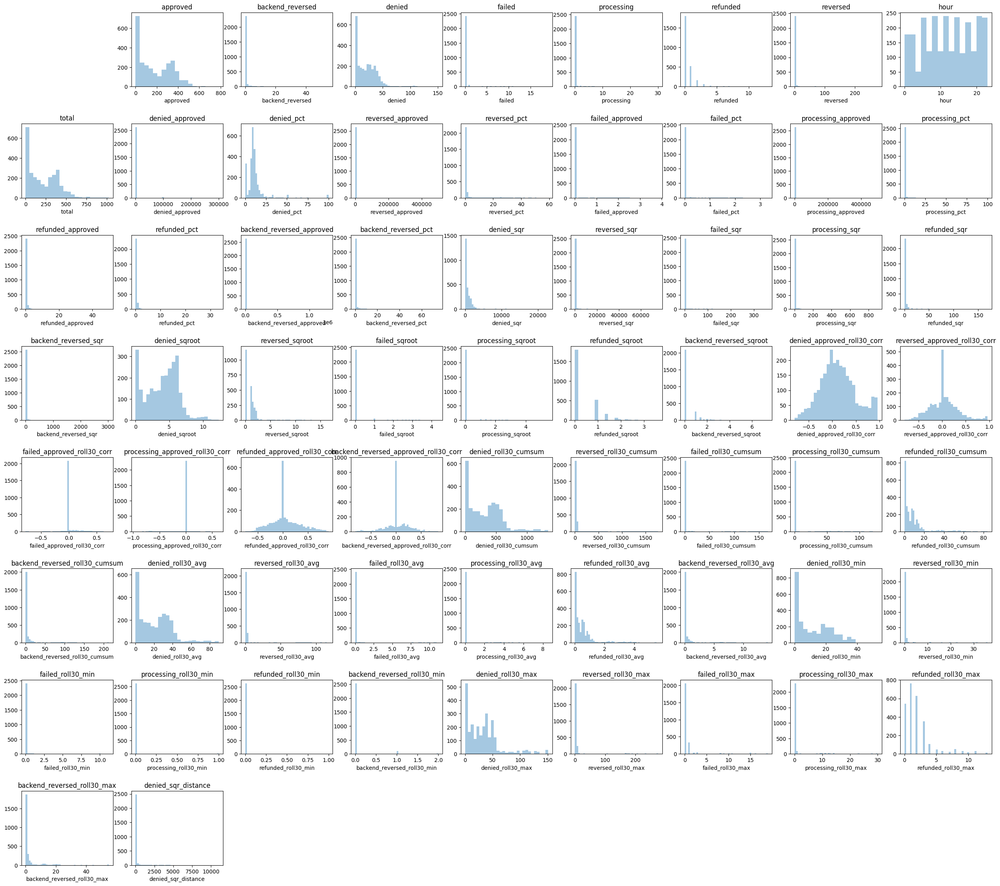

In [23]:

fig = plt.figure(figsize=(32,32))
fig.subplots_adjust(hspace=0.5, wspace=0.2)
for i, col in enumerate(transactions.columns):
    if col=='time':continue
    
    

  
    ax = fig.add_subplot(9, 9, i+1)
    sns.distplot(transactions[col], kde=False, ax=ax)    
    
    ax.set_title(col)


plt.show()

### Final Transformations

**Transforming hours to numerical**

In [24]:
transactions['hour'] = transactions.time.str[:2]
transactions.hour

0       00
1       00
2       00
3       00
4       00
        ..
2636    23
2637    23
2638    23
2639    23
2640    23
Name: hour, Length: 2641, dtype: object

In [25]:
transactions.drop('time', axis=1, inplace=True)

**One Hot Encoder for each Hour**

In [26]:
transactions = pd.get_dummies(transactions, 'hour', dtype=int)
transactions

,approved,backend_reversed,denied,failed,processing,refunded,reversed,total,denied_approved,denied_pct,...,hour_14,hour_15,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23
0,9.0,0.0,6.0,0.0,0.0,1.0,0.0,16.0,66.659260,37.500000,...,0,0,0,0,0,0,0,0,0,0
1,13.0,0.0,8.0,0.0,0.0,0.0,0.0,21.0,61.533728,38.095238,...,0,0,0,0,0,0,0,0,0,0
2,11.0,0.0,7.0,0.0,0.0,1.0,0.0,19.0,63.630579,36.842105,...,0,0,0,0,0,0,0,0,0,0
3,12.0,0.0,3.0,0.0,0.0,0.0,0.0,15.0,24.997917,20.000000,...,0,0,0,0,0,0,0,0,0,0
4,11.0,0.0,0.0,0.0,0.0,0.0,0.0,11.0,0.000000,0.000000,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2636,31.0,0.0,8.0,0.0,0.0,0.0,0.0,39.0,25.805619,20.512821,...,0,0,0,0,0,0,0,0,0,1
2637,34.0,0.0,8.0,0.0,0.0,0.0,0.0,42.0,23.528720,19.047619,...,0,0,0,0,0,0,0,0,0,1
2638,40.0,0.0,11.0,0.0,0.0,0.0,0.0,51.0,27.499313,21.568627,...,0,0,0,0,0,0,0,0,0,1
2639,35.0,0.0,4.0,0.0,0.0,0.0,0.0,39.0,11.428245,10.256410,...,0,0,0,0,0,0,0,0,0,1


In [27]:
transactions.columns

Index(['approved', 'backend_reversed', 'denied', 'failed', 'processing',
       'refunded', 'reversed', 'total', 'denied_approved', 'denied_pct',
       'reversed_approved', 'reversed_pct', 'failed_approved', 'failed_pct',
       'processing_approved', 'processing_pct', 'refunded_approved',
       'refunded_pct', 'backend_reversed_approved', 'backend_reversed_pct',
       'denied_sqr', 'reversed_sqr', 'failed_sqr', 'processing_sqr',
       'refunded_sqr', 'backend_reversed_sqr', 'denied_sqroot',
       'reversed_sqroot', 'failed_sqroot', 'processing_sqroot',
       'refunded_sqroot', 'backend_reversed_sqroot',
       'denied_approved_roll30_corr', 'reversed_approved_roll30_corr',
       'failed_approved_roll30_corr', 'processing_approved_roll30_corr',
       'refunded_approved_roll30_corr',
       'backend_reversed_approved_roll30_corr', 'denied_roll30_cumsum',
       'reversed_roll30_cumsum', 'failed_roll30_cumsum',
       'processing_roll30_cumsum', 'refunded_roll30_cumsum',
       '

In [28]:
for col in transactions.columns:
    pct = transactions[f'{col}'].isnull().sum() * 100 / len(transactions.index)
    print(f'{col} - {pct}%')

approved - 0.0%
backend_reversed - 0.0%
denied - 0.0%
failed - 0.0%
processing - 0.0%
refunded - 0.0%
reversed - 0.0%
total - 0.0%
denied_approved - 0.0%
denied_pct - 0.0%
reversed_approved - 0.0%
reversed_pct - 0.0%
failed_approved - 0.0%
failed_pct - 0.0%
processing_approved - 0.0%
processing_pct - 0.0%
refunded_approved - 0.0%
refunded_pct - 0.0%
backend_reversed_approved - 0.0%
backend_reversed_pct - 0.0%
denied_sqr - 0.0%
reversed_sqr - 0.0%
failed_sqr - 0.0%
processing_sqr - 0.0%
refunded_sqr - 0.0%
backend_reversed_sqr - 0.0%
denied_sqroot - 0.0%
reversed_sqroot - 0.0%
failed_sqroot - 0.0%
processing_sqroot - 0.0%
refunded_sqroot - 0.0%
backend_reversed_sqroot - 0.0%
denied_approved_roll30_corr - 0.0%
reversed_approved_roll30_corr - 0.0%
failed_approved_roll30_corr - 0.0%
processing_approved_roll30_corr - 0.0%
refunded_approved_roll30_corr - 0.0%
backend_reversed_approved_roll30_corr - 0.0%
denied_roll30_cumsum - 0.0%
reversed_roll30_cumsum - 0.0%
failed_roll30_cumsum - 0.0%
pro

# Principal Component Analysis (PCA)

We will  use PCA to analyse the importance of the features we created and reduce them to a smaller number of features. We can also try to detect anomalies with PCA through **reconstruction error** when reconstructing the features after reducing them through PCA.

We will use PCA and keep the features that sum a 95% of variance explained

In [29]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()

x = scaler.fit_transform(transactions)

pca = PCA(.95).set_output(transform='pandas')

reduced = pca.fit_transform(x)

print('Features Before PCA:  ',x.shape[1])
print('Features After PCA:  ',reduced.shape[1])



Features Before PCA:   87
Features After PCA:   33


Text(0.5, 1.0, 'Explained Variance by N component')

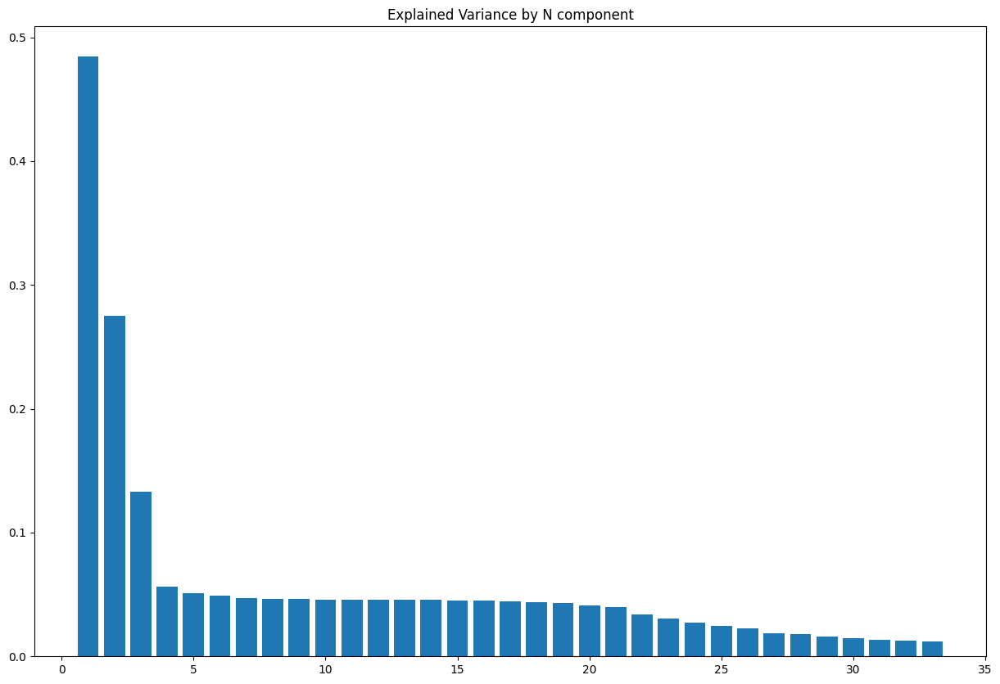

In [30]:
plt.figure(figsize=(15,10))
plt.bar(range(1, len(pca.explained_variance_) +1), pca.explained_variance_  )
plt.title('Explained Variance by N component')


Text(0.5, 1.0, 'Correlation of PCA Components x Data Features')

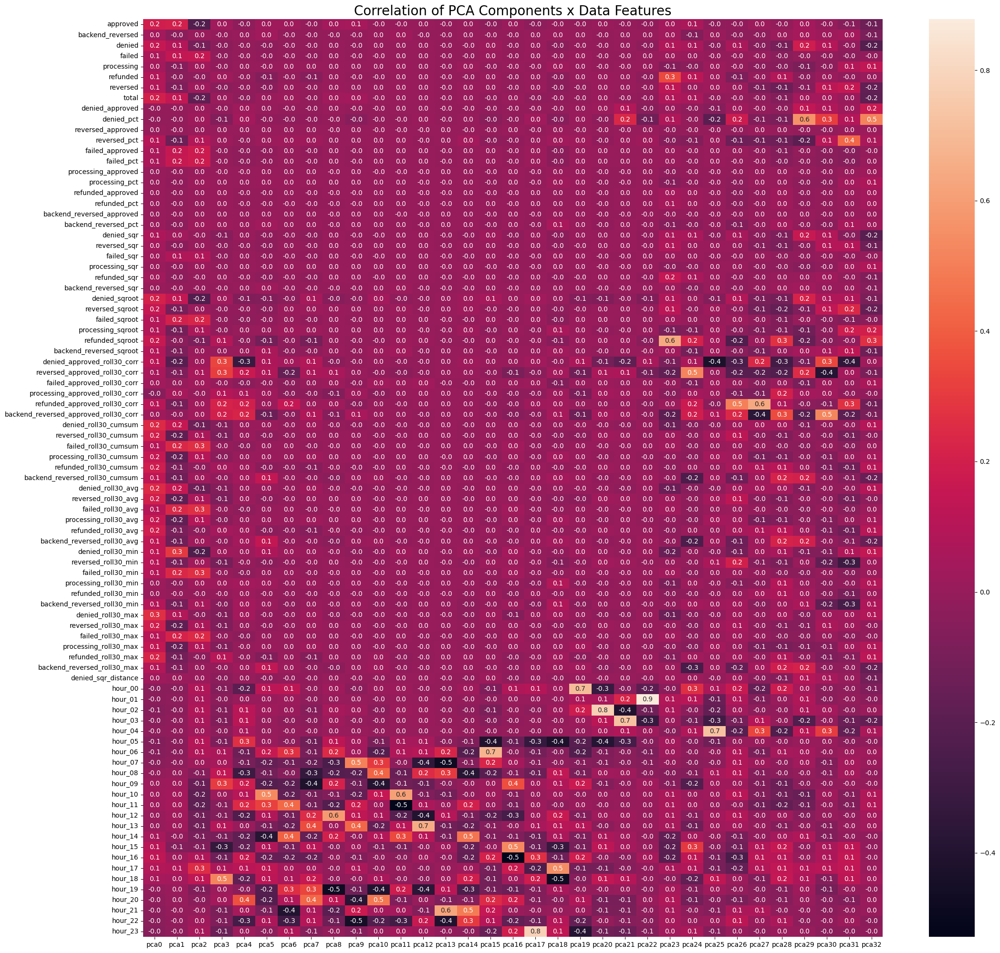

In [31]:
fig = plt.figure(figsize=(25,25))
components_df = pd.DataFrame(pca.components_ ,columns=transactions.columns ,index =pca.get_feature_names_out())
sns.heatmap(components_df.T, xticklabels=True, yticklabels=True, annot=True, fmt='.1f')
plt.title('Correlation of PCA Components x Data Features', fontsize=20)

## Reconstruction Error

Now that we reduced the data, we can reconstruct it through PCA and find errors in reconstruction. By subtracting the original scaled data from the reconstructed data we get the reconstruction error.

Text(0.5, 1.0, 'Sum of errors per Feature')

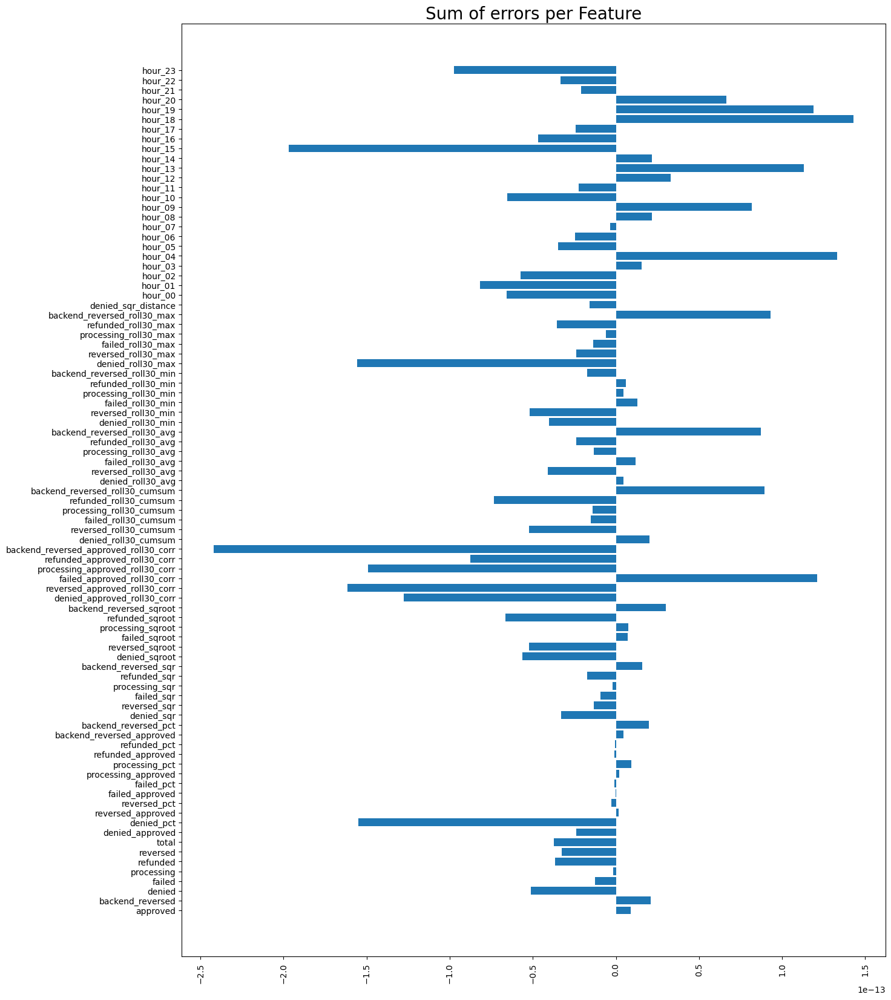

In [32]:
reverse_construct = pca.inverse_transform(reduced)
reconstruction_error = (reverse_construct - x)
reconstruction_error.columns = transactions.columns

plt.figure(figsize=(15,20))
plt.barh(reconstruction_error.columns, reconstruction_error.sum()  )
plt.xticks(rotation=90)
plt.title('Sum of errors per Feature', fontsize=20)

In [33]:
plt.figure(figsize=(20,10))
fig = go.Figure()

for col in reconstruction_error.columns:
    fig.add_trace(go.Scatter(x=reconstruction_error.index, y=reconstruction_error[col],
                        mode='lines',
                        name=col))

fig.update_layout(
    autosize=False,
    width=1200,
    height=900,
)

fig.update_layout(
    title=dict(text="Reconstruction Error over time", font=dict(size=30))
)

fig.show()

<Figure size 2000x1000 with 0 Axes>

## Looking Good

Our PCA model has some clear trends and anomalies detected, this is very promising for our anomaly detection and alert system. Let's check the average and the standard deviation of the errors so that maybe we can use the [3-sigma rule](https://en.wikipedia.org/wiki/68–95–99.7_rule#:~:text=In%20the%20empirical%20sciences%2C%20the,99.7%25%20probability%20as%20near%20certainty.) to rule out the anomalies

**Average of the averages**

In [34]:
reconstruction_error.mean().mean()

np.float64(-6.168952615209917e-18)

**Standard Deviations**

In [35]:
pd.DataFrame(reconstruction_error.std())

,0
approved,0.040513
backend_reversed,0.034633
denied,0.032984
failed,0.026389
processing,0.036593
...,...
hour_19,0.008720
hour_20,0.006816
hour_21,0.005729
hour_22,0.006516


**Average of Standard Deviations**

In [36]:
reconstruction_error.std().mean()

np.float64(0.02927367747523001)

**We will square the errors, so we can further seperate normal data from anomalies, this will also make all values positive. Then we take the average and the mean and use the 3-sigma rule to plot the anomalies**

In [37]:
re_squared = reconstruction_error**2

def rule_out(reconstruction_error:pd.Series, re_squared:pd.DataFrame):
    column = reconstruction_error.name
    mean = re_squared[column].mean()
    std = re_squared[column].std()
    
    sigma3 = mean + 3*std
    sgima3_negative  = mean - 3*std
    
 
    return (reconstruction_error >= sigma3) | (reconstruction_error <= sgima3_negative)
   


    

In [38]:
plt.figure(figsize=(20,10))
fig = go.Figure()

for col in re_squared.columns:
    anomalies = re_squared[col].mask( ~rule_out(re_squared[col], re_squared) )
    fig.add_trace(go.Scatter(x=reconstruction_error.index, y=anomalies,
                        mode='markers',
                        name=col))

fig.update_layout(
    autosize=False,
    width=1200,
    height=900,
)

fig.update_layout(
    title=dict(text="Reconstruction Error over time", font=dict(size=30))
)

fig.show()

<Figure size 2000x1000 with 0 Axes>

## Disturbance Readings

We will use **Softmax** to see how much each feature contributes to the total of the reconstruction error, then we will stack the values to create a kind of *seismometer*. Unfortunately we can't put the labels because there are too many of them and it wouldn't help to understand the data, but you will see that it does help to identify anomalous behavior

(0.0, 1.0)

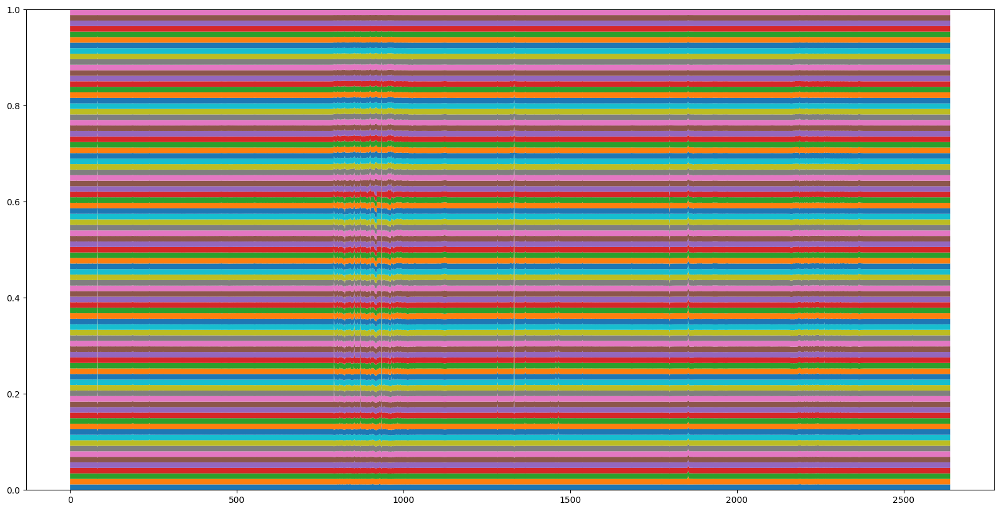

In [39]:
from scipy.special import softmax
plt.figure(figsize=(20,10))


labels = re_squared.columns

re_squared = pd.DataFrame(softmax(re_squared, axis=1), columns=labels)


plt.stackplot(re_squared.index, *[re_squared[column] for column in labels],
             labels = labels)



plt.ylim(0,1)

The small *scribbles* you see are from anomalies that bump the other stacks because of it's higher contribution towards the total error. As softmax adds everything up to 1, it's natural that the oter features lose space in the readings. That's why this graph helps a lot in finding anomalies

(0.0, 1.0)

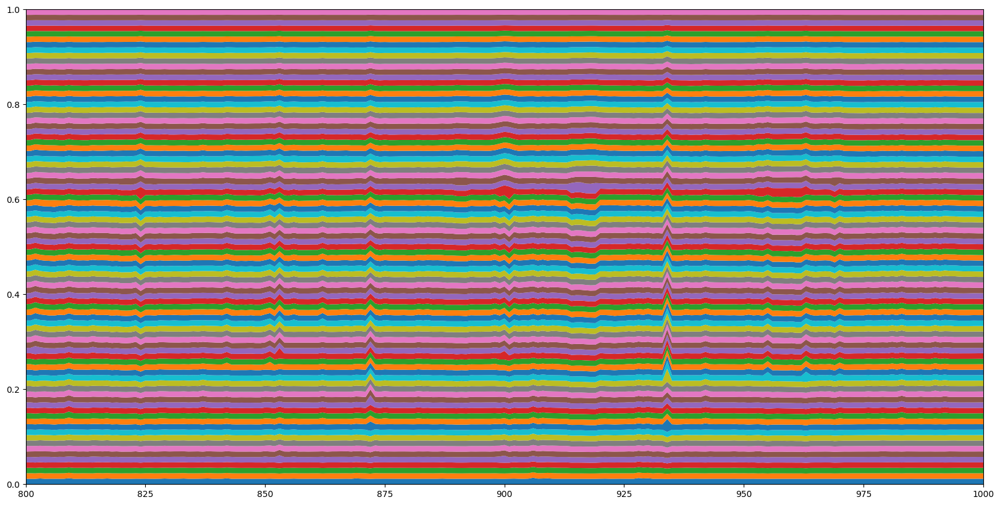

In [40]:
plt.figure(figsize=(20,10))
plt.stackplot(re_squared.index, *[re_squared[column] for column in labels],
             labels = labels)


plt.xlim(800, 1000)
plt.ylim(0,1)

It mighte seem small, but remember these are 87 features. With softmax making all the feature errors summing to 1, that leaves about ~1% for each feature to contribute 

In [41]:
re_squared.mean()

approved            0.011500
backend_reversed    0.011496
denied              0.011494
failed              0.011489
processing          0.011497
                      ...   
hour_19             0.011482
hour_20             0.011482
hour_21             0.011482
hour_22             0.011482
hour_23             0.011482
Length: 87, dtype: float64

In [42]:
re_squared.max().sort_values(ascending=False)

processing_approved          0.028251
refunded_roll30_min          0.027583
backend_reversed_approved    0.027390
reversed_approved            0.027317
refunded_approved            0.027189
                               ...   
hour_19                      0.011494
hour_08                      0.011494
hour_20                      0.011494
hour_21                      0.011494
hour_22                      0.011494
Length: 87, dtype: float64

As we can see, the average of the error values is around 1.14% which is very small. But the max values i.e. the main anomalous values go up to almost 3% which is a large difference from the normal readings

## Why PCA

The reason we will stick with using PCA for this and not using other alternative models for anomaly detection is the following:

- PCA can handle these smaller datasets, which other models tend to not perform well
- Our PCA approach has a very good "lead" on spotting anomalies
- There is a hand few of other anomaly detection algorithms that could work, but testing each approach would require time we don't have

# Final Touches

We will do the final touches so we can focus on the API and systems. Creating functions to receive the data, transform and detect anomalies. Saving the models to use later, etc.

**Dict to save means and standard deviations for anomaly detection**

In [43]:
re_squared = reconstruction_error**2


means_dict = {}
for col in re_squared.columns:
    mean = re_squared[col].mean()
    std = re_squared[col].std()
    means_dict.update(
        {col:{'mean':mean,'std':std}}
    )
    

Function to receive raw data in a API and detect anomalies, returning a dictionary

In [44]:
def detect_anomalies(data:pd.DataFrame):
    anomaly_dict = {}

    columns = data.columns 
    data = scaler.transform(data)
    pca_transformed = pca.transform(data)
    pca_inversed = pca.inverse_transform(pca_transformed)
    pca_inversed.columns = data.columns
    data = (data - pca_inversed)**2
    softmax_data = softmax(data)
    
    
    
    for col in data.columns:
        mean = means_dict.get(col).get('mean')
        std = means_dict.get(col).get('std')

        sigma3 = mean + 3*std
        sgima3_negative  = mean - 3*std

        value = data[col].values[0]
        key = col.split('_')[0]
        pct = softmax_data[col].values[0]

        if  value >= sigma3 or value <= sgima3_negative: anomaly = True
            
        else: anomaly = False
            

        anomaly_dict.update({key: {'anomaly':anomaly, 'value':value,'pct':pct}})

    return anomaly_dict
            
            
                
        
        

Saving models and important data in files

In [45]:
import joblib
import pickle 

joblib.dump(scaler, 'scaler.save')
joblib.dump(pca, 'pca.save')
joblib.dump(linearR_denied, 'linearR_denied.save')


with open('means_dict.pkl', 'wb') as f:
    pickle.dump(means_dict, f)
